Задания
1. Выберите одну из моделей (YOLOv8 или Faster R-CNN).
2. Загрузите предобученную модель и примените её к набору изображений (COCO subset, Pascal VOC или небольшой кастомный датасет).
3. Проведите fine-tuning на кастомном датасете (5–10 классов).
4. Оцените качество модели: постройте метрику mAP при разных IoU порогах.
5. Визуализируйте предсказания модели на тестовых изображениях.

# Задание 1

была выбрана модель YOLOv8, так как название показалось интересным

In [1]:
import os
import json
import shutil

import urllib.request
from zipfile import ZipFile

import torch
from ultralytics import YOLO
import glob
from pathlib import Path
import pandas as pd
from pycocotools.coco import COCO
import matplotlib.pyplot as plt
from PIL import Image

In [2]:
# Была выбрана модель Yolov8
model = YOLO("yolov8n.pt")  

# Задание 2

1. Использовался датасет COCO.
2. Не совсем ясно, что значит применить (относительно 3 задания дальше). Ну пожалуй просто к тестовым изображениям применим

In [3]:
test_images_path = '../coco/coco2017/test2017'
test_images = os.listdir(test_images_path)[:30]
test_images_full_paths = [f'{test_images_path}/{img}' for img in test_images]
results = model.predict(source=test_images_full_paths, save=True, save_txt=False)


0: 640x640 1 car, 1 truck, 1 parking meter, 1.6ms
1: 640x640 2 persons, 1 sports ball, 1 baseball bat, 1.6ms
2: 640x640 2 cows, 1.6ms
3: 640x640 1 person, 1 sports ball, 1 tennis racket, 1.6ms
4: 640x640 2 persons, 1 sports ball, 1 baseball bat, 1.6ms
5: 640x640 4 persons, 3 wine glasss, 1 dining table, 1 laptop, 1.6ms
6: 640x640 3 zebras, 1.6ms
7: 640x640 1 cow, 1.6ms
8: 640x640 1 bird, 1 frisbee, 1 bowl, 1.6ms
9: 640x640 1 train, 1.6ms
10: 640x640 1 elephant, 1.6ms
11: 640x640 2 teddy bears, 1.6ms
12: 640x640 1 fork, 3 broccolis, 1 carrot, 1.6ms
13: 640x640 1 person, 1 tie, 1.6ms
14: 640x640 2 motorcycles, 1.6ms
15: 640x640 1 bear, 1.6ms
16: 640x640 2 bottles, 1 wine glass, 1 cup, 1 dining table, 1.6ms
17: 640x640 1 remote, 1 keyboard, 1.6ms
18: 640x640 1 airplane, 1.6ms
19: 640x640 3 persons, 1 bicycle, 2 ties, 1.6ms
20: 640x640 1 fork, 1 dining table, 1.6ms
21: 640x640 2 persons, 2 skateboards, 1.6ms
22: 640x640 1 giraffe, 1.6ms
23: 640x640 1 person, 1.6ms
24: 640x640 4 chairs, 2 

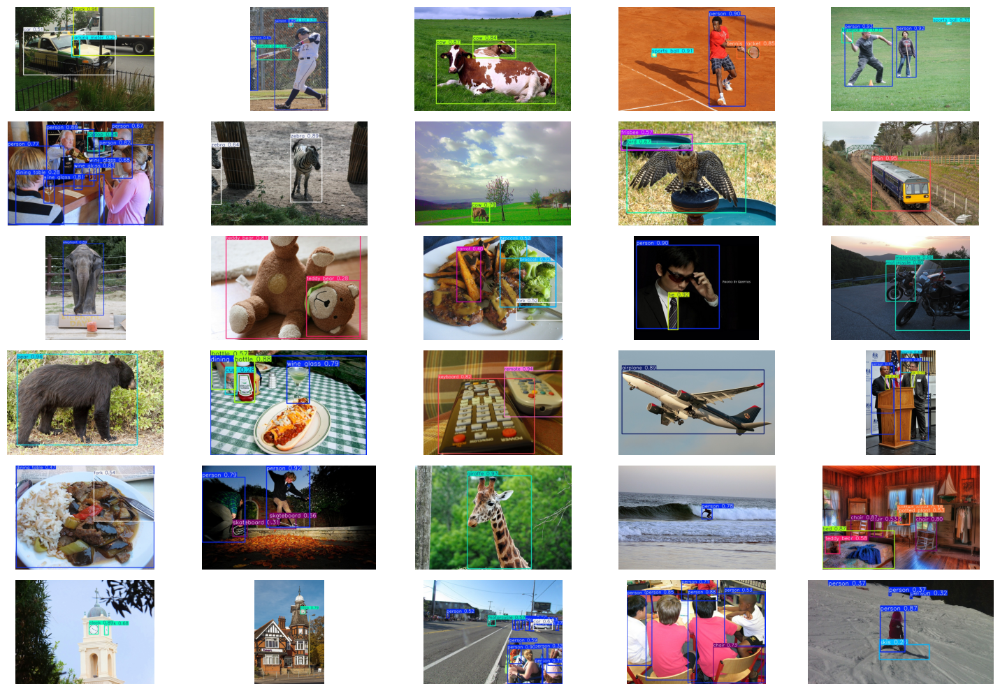

In [4]:
# Создаем фигуру с сеткой 5x6
fig, axes = plt.subplots(6, 5, figsize=(15, 10))

for i, ax in enumerate(axes.flat):
    img_path = os.path.join(f'./task1_predict/{test_images[i]}')
    img = Image.open(img_path)
    ax.imshow(img)
    ax.axis('off')

plt.tight_layout()
plt.show()

# Задание 3

Создаем кастомный датасет на основе COCO

In [5]:
train_annotation_path = "../coco/coco2017/annotations/instances_train2017.json"
val_annotation_path = "../coco/coco2017/annotations/instances_val2017.json"
train_images_dir = "./dataset/images/train"
val_images_dir = "./dataset/images/val"
output_labels_train_dir = "./dataset/labels/train"
output_labels_val_dir = "./dataset/labels/val"

In [6]:
def convert_bbox_to_yolo(image_width, image_height, bbox):
    x, y, w, h = bbox
    x_center = (x + w / 2) / image_width
    y_center = (y + h / 2) / image_height
    w = w / image_width
    h = h / image_height
    return x_center, y_center, w, h

def process_coco_annotations(annotation_path, output_labels_dir, images_dir, nc = 200):
    os.makedirs(output_labels_dir, exist_ok=True)
    coco = COCO(annotation_path)

    for img_id in coco.getImgIds():

        img_info = coco.loadImgs([img_id])[0]
        
        img_filename = img_info['file_name']
        img_path = f'{images_dir}/{img_filename}'
        
        if not os.path.exists(img_path):
            print(f"Не найдено изображение {img_filename} в папке {images_dir}")
            continue

        img_width, img_height = img_info['width'], img_info['height']
        
        annotations = coco.loadAnns(coco.getAnnIds(imgIds=[img_id]))
        

        label_file_path = f'{output_labels_dir}/{img_filename.replace('.jpg', '.txt')}'
        with open(label_file_path, 'w') as label_file:
            
            seen_labels = set()
            for ann in annotations:
                if 'bbox' in ann:
                    bbox = convert_bbox_to_yolo(img_width, img_height, ann['bbox'])
                    class_id = ann['category_id'] - 1
                    
                    if class_id >= nc:
                        continue
                    label_str = f"{class_id} {' '.join(map(str, bbox))}\n"
                    if label_str not in seen_labels:
                        label_file.write(label_str)
                        seen_labels.add(label_str)
                    else:
                        print(f"Дубликация {img_filename}. Пропуск изображения.")


process_coco_annotations(train_annotation_path, output_labels_train_dir, train_images_dir, nc = 10)
process_coco_annotations(val_annotation_path, output_labels_val_dir, val_images_dir, nc = 10)

loading annotations into memory...
Done (t=5.93s)
creating index...
index created!
Дубликация 000000099844.jpg. Пропуск изображения.
Дубликация 000000099844.jpg. Пропуск изображения.
loading annotations into memory...
Done (t=0.33s)
creating index...
index created!


Вообще интересная "штука". В момент, когда я запускаю обучение модели, скачивается версия yolo11n. Мне, честно говоря, непонятно почему, так как я задаю точное название модели. Немного погуглил - это возникает для того, чтобы проходить AMP тесты (незря все таки в логах AMP в начале строки). AMP в моем понимании это технология, которая позволяет часть вычислений проводить с двойной точностью (float16), а часть с четверной (float32), там где более высокая точность необходима. Эта технология нужна для увеличения скорости вычислений


In [7]:
model = YOLO('yolov8n.pt')
model.train(
    data='custom_dataset.yaml',
    epochs=5,
    imgsz=640,
    batch=16,
    lr0=0.01,
    device='cuda' if torch.cuda.is_available() else 'cpu'
)


New https://pypi.org/project/ultralytics/8.3.228 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.222  Python-3.13.7 torch-2.9.0+cu130 CUDA:0 (NVIDIA GeForce RTX 5070, 12227MiB)
engine\trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=custom_dataset.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=5, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train6, nbs=64, nms=False, opset=None

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x0000027E0823FD10>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,   

In [8]:
model.save('trained_yolov8n.pt')

# Задание 4

In [ ]:
model_v = YOLO('trained_yolov8n.pt')

In [10]:
# Пример инференса на изображении
image_path = f"{train_images_dir}/000000000307.jpg"
results = model_v(image_path)
 

# Сохранение изображения с предсказаниями в файл
results[0].save(filename="result.jpg")
results[0].show() 


image 1/1 d:\\\3 \    \lab1\dataset\images\train\000000000307.jpg: 480x640 1 car, 21.6ms
Speed: 0.9ms preprocess, 21.6ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


In [13]:
metrics = model_v.val(data="custom_dataset.yaml")
print(f"mAP50-95: {metrics.box.map:.3f}, mAP50: {metrics.box.map50:.3f}, mAP75: {metrics.box.map75:.3f}")

Ultralytics 8.3.222  Python-3.13.7 torch-2.9.0+cu130 CUDA:0 (NVIDIA GeForce RTX 5070, 12227MiB)
val: Fast image access  (ping: 0.10.0 ms, read: 1171.2209.2 MB/s, size: 140.4 KB)
val: Scanning D:\ВУЗ\МАГА\3 семместр\Нейронные сети и глубокое обучение\lab1\dataset\labels\val.cache... 5000 images, 1850 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 5000/5000 10.8Mit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 313/313 18.1it/s 17.3s0.1s
                   all       5000      15723      0.669      0.516      0.578      0.385
                person       2693      11004      0.761       0.65      0.728      0.496
               bicycle        149        316      0.636      0.348      0.406      0.235
                   car        535       1932      0.638       0.51      0.557      0.352
            motorcycle        159        371      0.715      0.553      0.635      0.375
              airplane         97        143      0.

In [22]:
def show_image(num_images, folder_path, image_files, cols, rows):
    fig, axes = plt.subplots(rows, cols, figsize=(12, rows * 6))  
    for i, ax in enumerate(axes.flat):
        if i < num_images:
            img_path = os.path.join(folder_path, image_files[i])
            try:
                img = Image.open(img_path)
                ax.imshow(img)
                ax.set_title(image_files[i], fontsize=10)
                ax.axis('off')
            except Exception as e:
                ax.text(0.5, 0.5, f"Ошибка: {image_files[i]}\n{str(e)}", ha='center', va='center')
        else:
            ax.axis('off')

    plt.tight_layout()
    plt.show()

## Визуализация на обучении

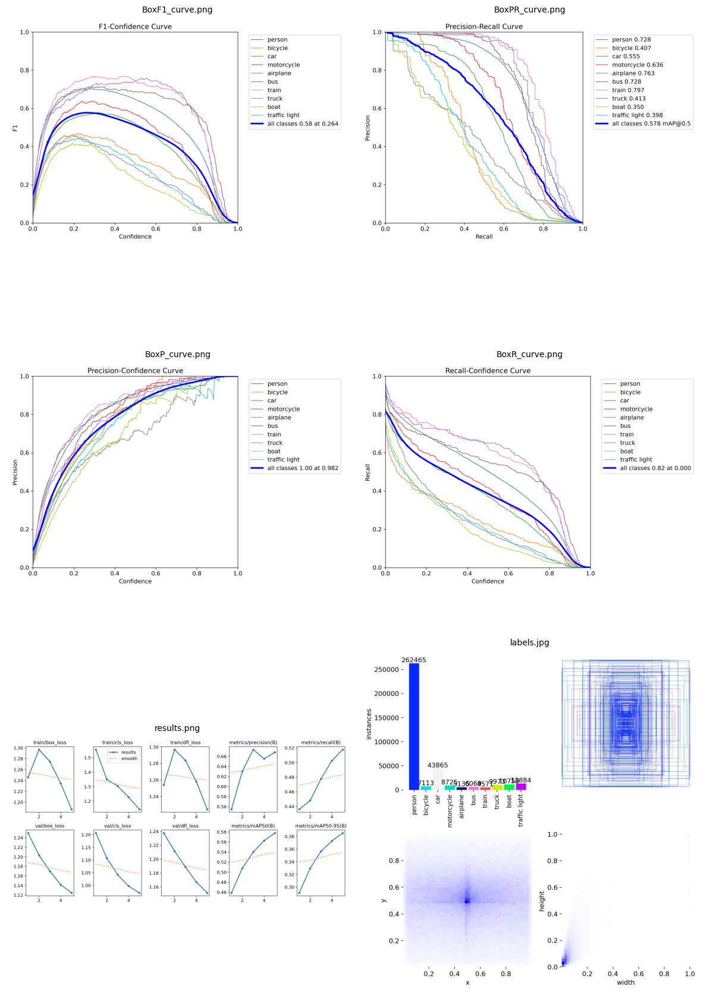

In [23]:
folder_path = './runs/detect/train6'

image_files = ['BoxF1_curve.png',
 'BoxPR_curve.png',
 'BoxP_curve.png',
 'BoxR_curve.png',
 'results.png',
 'labels.jpg',]
cols = 2
rows = 3
num_images = 6


show_image(num_images, folder_path, image_files, cols, rows)

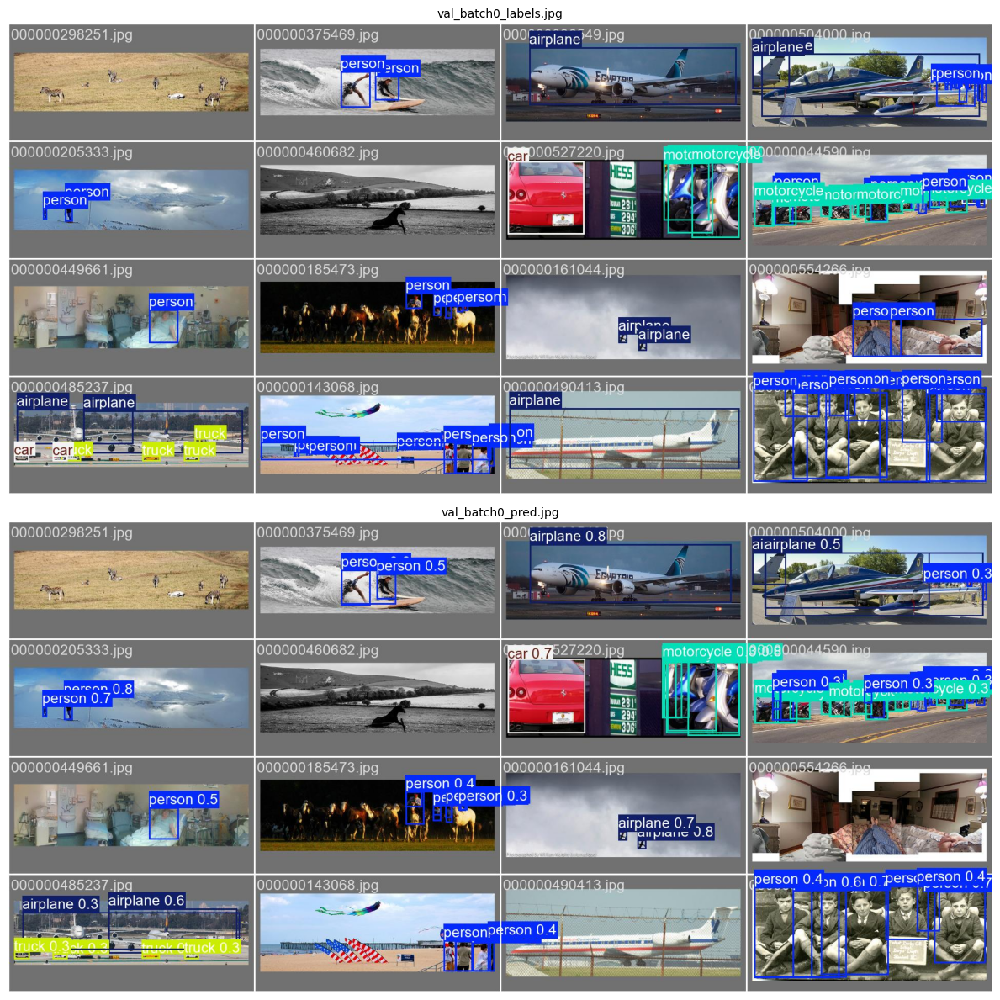

In [24]:
folder_path = './runs/detect/train6'

image_files = ['val_batch0_labels.jpg',
 'val_batch0_pred.jpg']
cols = 1
rows = 2
num_images = 2
show_image(num_images, folder_path, image_files, cols, rows)

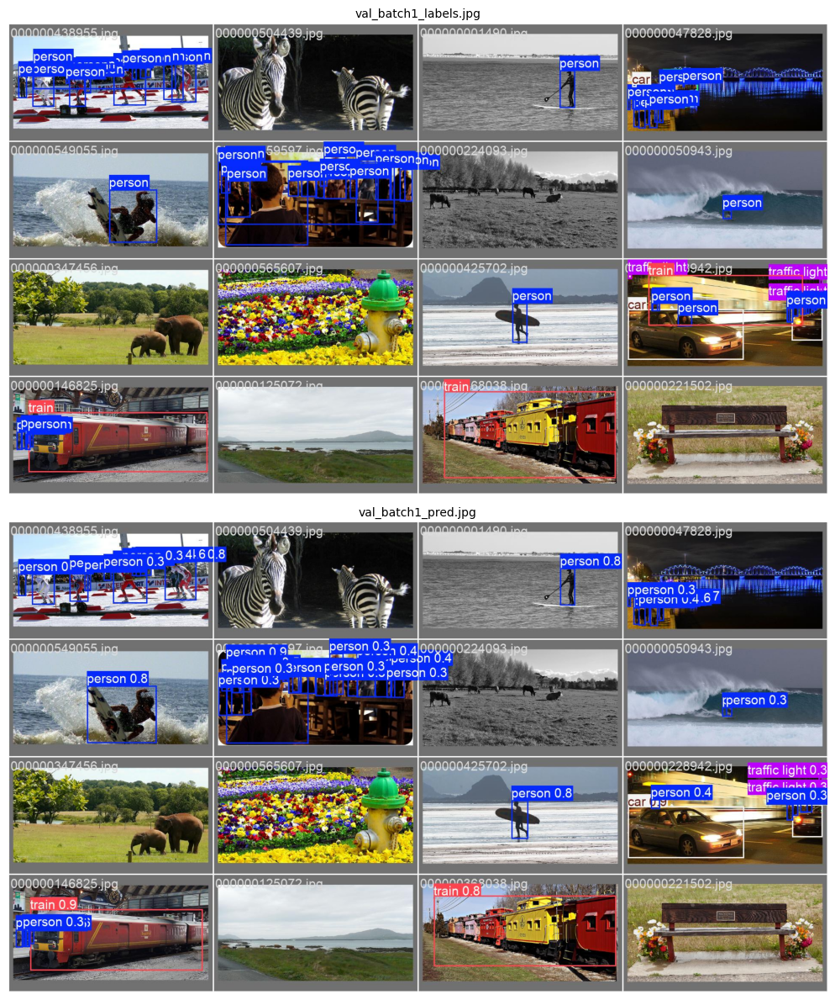

In [25]:
folder_path = './runs/detect/train6'

image_files = ['val_batch1_labels.jpg',
 'val_batch1_pred.jpg']
cols = 1
rows = 2
num_images = 2
show_image(num_images, folder_path, image_files, cols, rows)

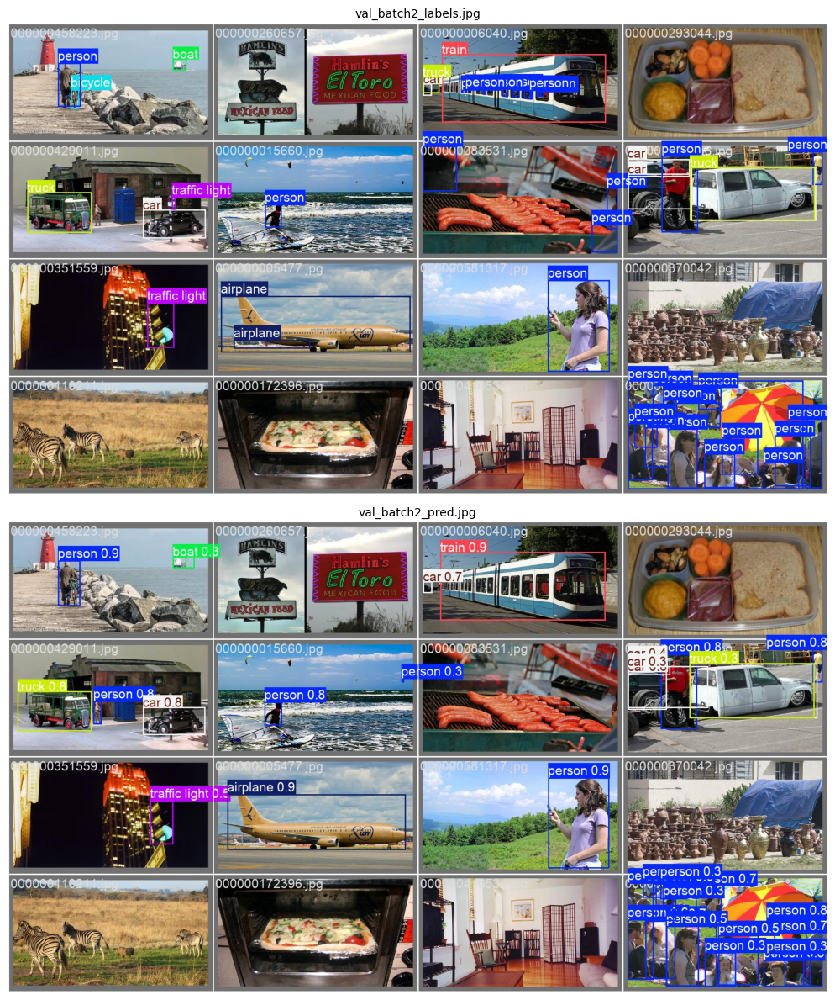

In [26]:
folder_path = './runs/detect/train6'

image_files = ['val_batch2_labels.jpg',
 'val_batch2_pred.jpg']
cols = 1
rows = 2
num_images = 2
show_image(num_images, folder_path, image_files, cols, rows)

## Визуализация на валидации

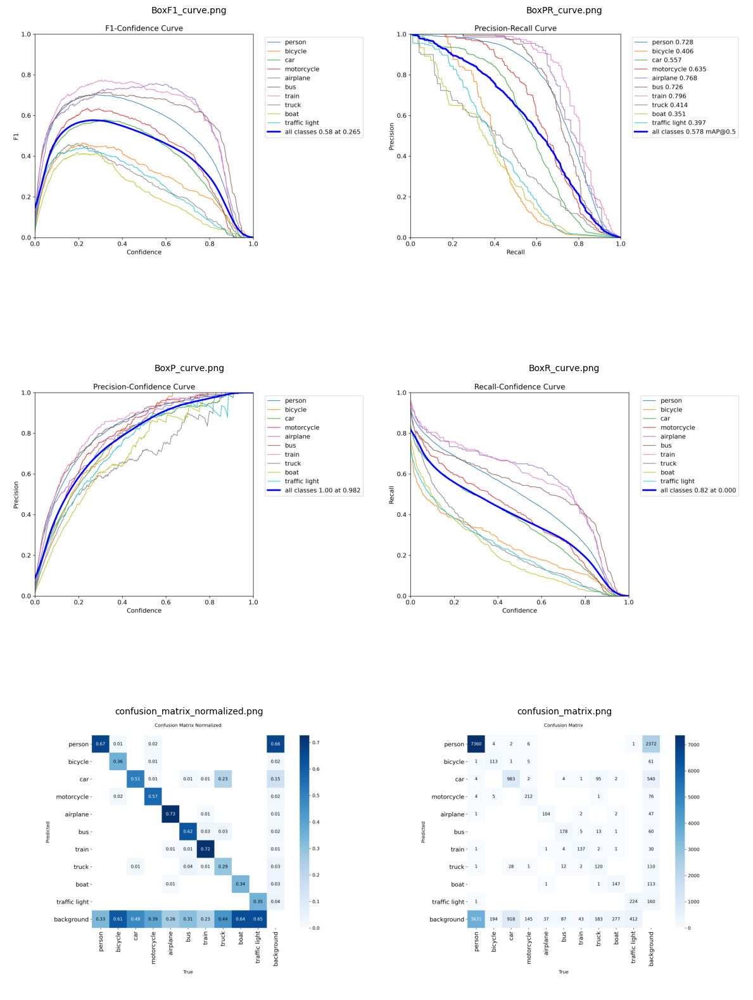

In [30]:
folder_path = './runs/detect/val4'

image_files = ['BoxF1_curve.png',
 'BoxPR_curve.png',
 'BoxP_curve.png',
 'BoxR_curve.png',
 'confusion_matrix_normalized.png',
 'confusion_matrix.png',]
cols = 2
rows = 3
num_images = 6


show_image(num_images, folder_path, image_files, cols, rows)

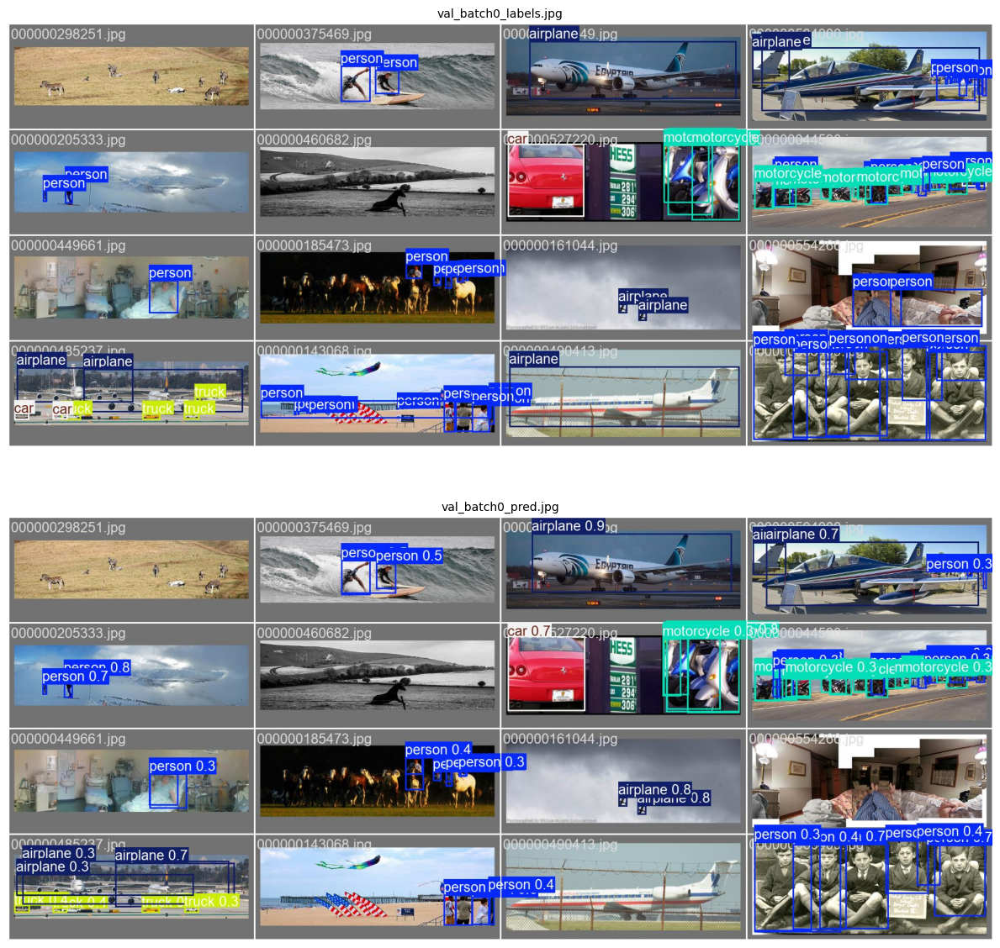

In [31]:
folder_path = './runs/detect/val4'

image_files = ['val_batch0_labels.jpg',
 'val_batch0_pred.jpg']
cols = 1
rows = 2
num_images = 2
show_image(num_images, folder_path, image_files, cols, rows)

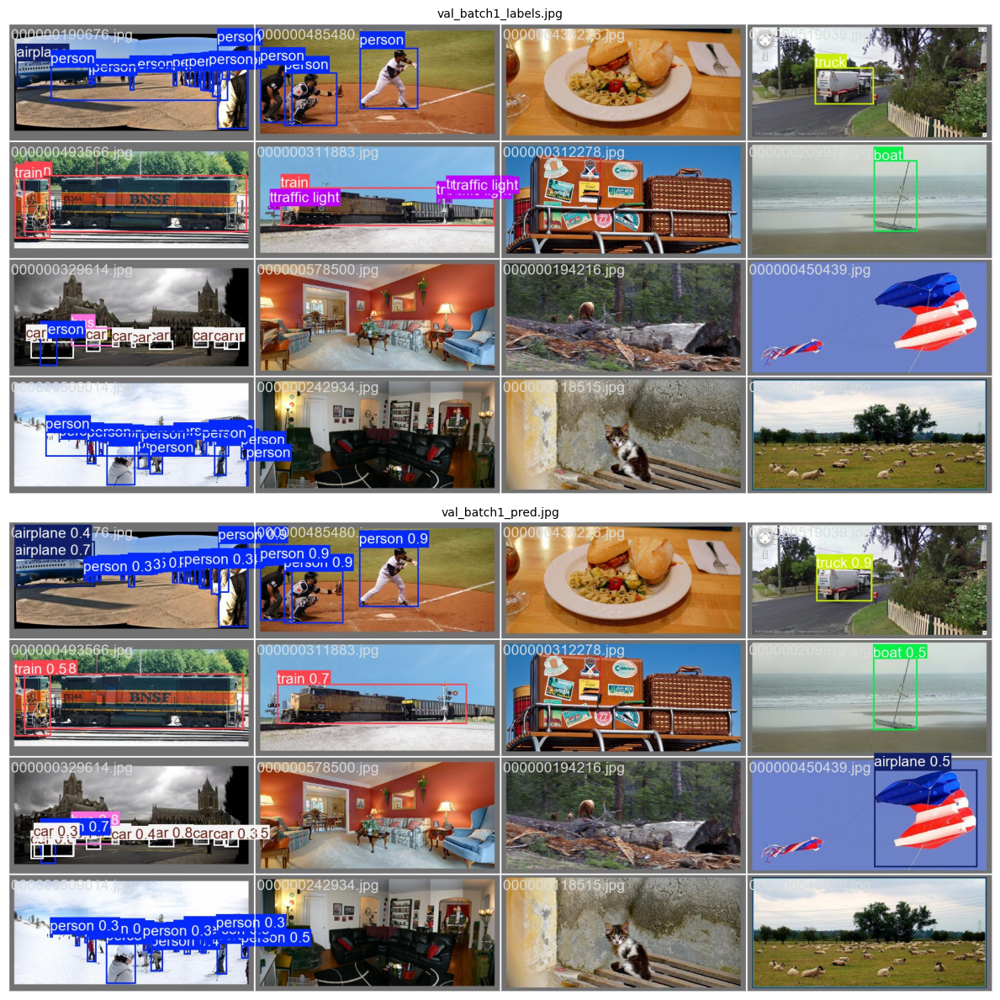

In [32]:
folder_path = './runs/detect/val4'

image_files = ['val_batch1_labels.jpg',
 'val_batch1_pred.jpg']
cols = 1
rows = 2
num_images = 2
show_image(num_images, folder_path, image_files, cols, rows)

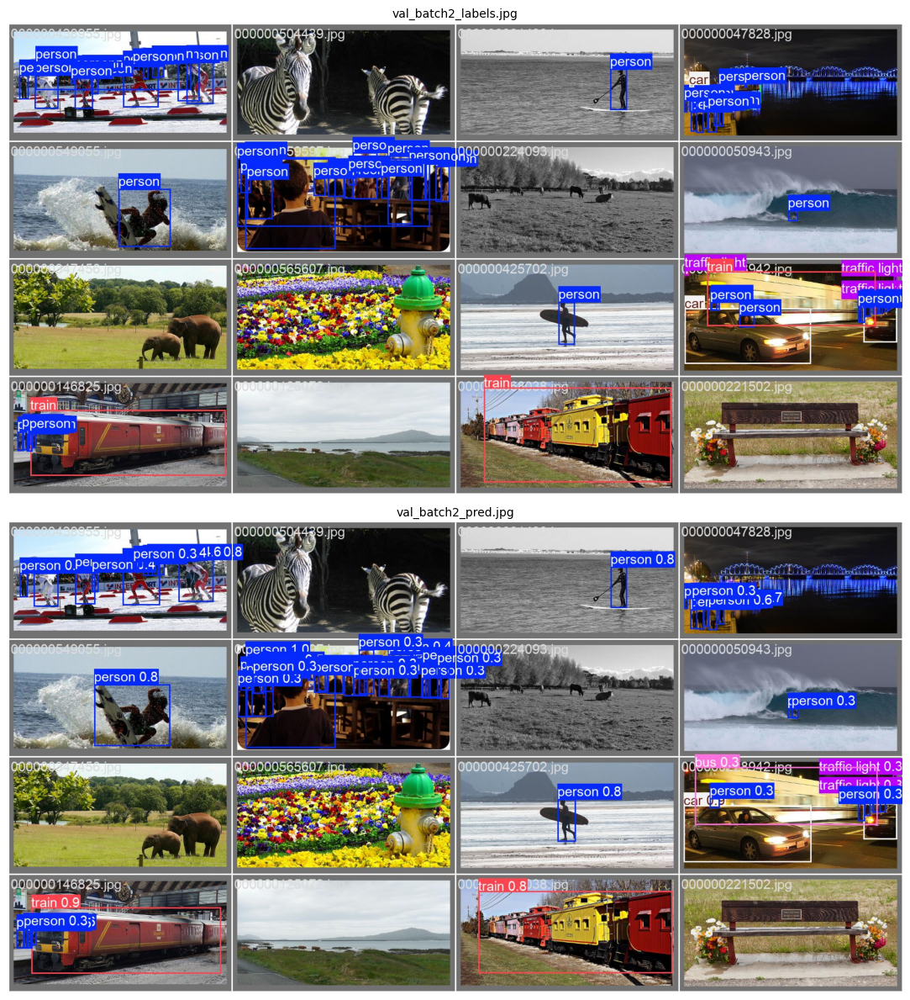

In [33]:
folder_path = './runs/detect/val4'

image_files = ['val_batch2_labels.jpg',
 'val_batch2_pred.jpg']
cols = 1
rows = 2
num_images = 2
show_image(num_images, folder_path, image_files, cols, rows)

## Своеобразный вывод:
1. Проблема в датасете (сильно несбалансированный), слишком часто встречается person.
2. В основном объекты предсказываются в центре изображения с размером <0.4 от всего изображения.
3. Метрики на обучении растут, loss падает. Хотелось бы поставить больше эпох и посмотреть что будет дальше, но даже для 5 обучение которых зяняло час (а в ходе выполнения лабы, пришлось несколько раз перезапускать).
4. Ну и модель хорошо предсказывает слишком частые классы, но плохо предсказывает редкие 

# Задание 5

In [34]:
test_images_path = '../coco/coco2017/test2017'
test_images = os.listdir(test_images_path)[:30]
test_images_full_paths = [f'{test_images_path}/{img}' for img in test_images]
results = model_v.predict(source=test_images_full_paths, save=True, save_txt=False)


0: 640x640 1 train, 1 truck, 1.2ms
1: 640x640 3 persons, 1.2ms
2: 640x640 (no detections), 1.2ms
3: 640x640 1 person, 1.2ms
4: 640x640 2 persons, 1.2ms
5: 640x640 4 persons, 1.2ms
6: 640x640 (no detections), 1.2ms
7: 640x640 (no detections), 1.2ms
8: 640x640 (no detections), 1.2ms
9: 640x640 1 train, 1.2ms
10: 640x640 (no detections), 1.2ms
11: 640x640 (no detections), 1.2ms
12: 640x640 (no detections), 1.2ms
13: 640x640 1 person, 1.2ms
14: 640x640 2 motorcycles, 1.2ms
15: 640x640 (no detections), 1.2ms
16: 640x640 (no detections), 1.2ms
17: 640x640 (no detections), 1.2ms
18: 640x640 1 airplane, 1.2ms
19: 640x640 2 persons, 1.2ms
20: 640x640 (no detections), 1.2ms
21: 640x640 2 persons, 1.2ms
22: 640x640 (no detections), 1.2ms
23: 640x640 1 person, 1.2ms
24: 640x640 (no detections), 1.2ms
25: 640x640 (no detections), 1.2ms
26: 640x640 (no detections), 1.2ms
27: 640x640 13 persons, 2 cars, 2 motorcycles, 1.2ms
28: 640x640 5 persons, 1.2ms
29: 640x640 2 persons, 1.2ms
Speed: 1.2ms prepr

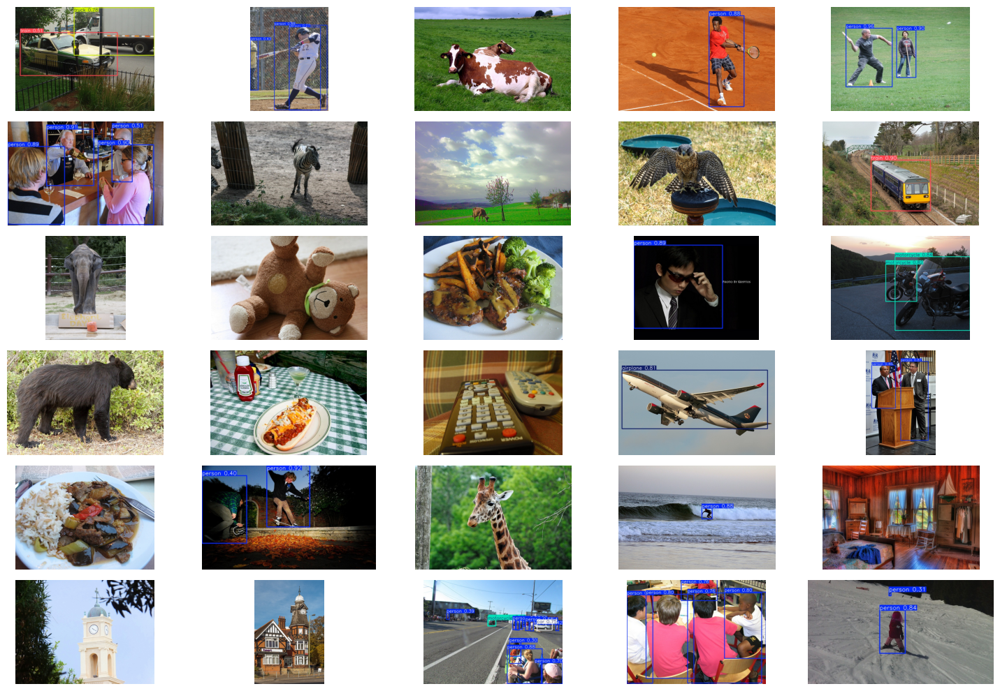

In [35]:
# Создаем фигуру с сеткой 5x6
fig, axes = plt.subplots(6, 5, figsize=(15, 10))

for i, ax in enumerate(axes.flat):
    img_path = os.path.join(f'./task5_predict/{test_images[i]}')
    img = Image.open(img_path)
    ax.imshow(img)
    ax.axis('off')

plt.tight_layout()
plt.show()